In [ ]:
import pandas as pd
import numpy as np
from gensim.models import doc2vec
from gensim.models.doc2vec import  Doc2Vec

In [ ]:
df=pd.read_csv('clean_data (1).csv')
df.head()

,Unnamed: 0,ID,text,clean_text
0,0,57,"Every person has a right to profess, practice ...",person profess practice propagate religion he ...
1,1,1603,"That is , the pigment particles mix with the v...",pigment particle mix vehicle particle distribu...
2,2,755,The Prime Minister of India is the leader of t...,prime minister india leader ruling party lok s...
3,3,1636,The water you drink now-a-days is not safe .,water drink nowadays safe
4,4,828,"I , along with my mother , brothers and sister...",mother brother sister brought small bamboo


In [ ]:
word_list=[]

In [ ]:
for i in df['clean_text']:
    i=str(i)
    li=list(i.split(" "))
    word_list.append(li)

In [ ]:
word_list

[['person',
  'profess',
  'practice',
  'propagate',
  'religion',
  'he',
  'she',
  'belief',
  'religious',
  'group',
  'sect',
  'free',
  'manage',
  'religious',
  'affair',
  'propagate',
  'religion',
  'person',
  'compel',
  'person',
  'convert',
  'his',
  'religion',
  'force',
  'fraud',
  'inducement',
  'allurement',
  'person',
  'free',
  'change',
  'religion',
  'his',
  'her',
  'freedom',
  'practice',
  'religion',
  'person',
  'he',
  'religion',
  'sacrifice',
  'animal',
  'human',
  'being',
  'offering',
  'supernatural',
  'force',
  'god',
  'religious',
  'practice',
  'treat',
  'woman',
  'inferior',
  'infringe',
  'woman',
  'freedom',
  'allowed',
  'force',
  'widowed',
  'woman',
  'shave',
  'head',
  'wear',
  'white',
  'clothes'],
 ['pigment',
  'particle',
  'mix',
  'vehicle',
  'particle',
  'distributed',
  'equal',
  'distance',
  'liquid'],
 ['prime',
  'minister',
  'india',
  'leader',
  'ruling',
  'party',
  'lok',
  'sabha',
  'mp

In [ ]:
len(word_list)

2000

In [ ]:
for i, list_of_words in enumerate(word_list):
        #yield doc2vec.TaggedDocument(word_list, [i])
        print(i)
        print(list_of_words)
        break

0
['person', 'profess', 'practice', 'propagate', 'religion', 'he', 'she', 'belief', 'religious', 'group', 'sect', 'free', 'manage', 'religious', 'affair', 'propagate', 'religion', 'person', 'compel', 'person', 'convert', 'his', 'religion', 'force', 'fraud', 'inducement', 'allurement', 'person', 'free', 'change', 'religion', 'his', 'her', 'freedom', 'practice', 'religion', 'person', 'he', 'religion', 'sacrifice', 'animal', 'human', 'being', 'offering', 'supernatural', 'force', 'god', 'religious', 'practice', 'treat', 'woman', 'inferior', 'infringe', 'woman', 'freedom', 'allowed', 'force', 'widowed', 'woman', 'shave', 'head', 'wear', 'white', 'clothes']


In [ ]:
def tagged_document(list_of_list_of_words):
    
    for i, list_of_words in enumerate(list_of_list_of_words):
        yield doc2vec.TaggedDocument(list_of_words, [i])
data_training = list(tagged_document(word_list))
print(data_training[1])

TaggedDocument(['pigment', 'particle', 'mix', 'vehicle', 'particle', 'distributed', 'equal', 'distance', 'liquid'], [1])


In [ ]:
model = Doc2Vec(vector_size=40, min_count=2, epochs=30)

In [ ]:
model.build_vocab(data_training)

In [ ]:
model.train(data_training,total_examples=model.corpus_count,epochs=model.epochs)

In [ ]:
print(model.infer_vector("person profess practice propagate religion he".split()))

[ 0.01364023  0.05848311 -0.1085351   0.12695402  0.00100739  0.01714597
 -0.09417997  0.02654008  0.140294    0.05559603  0.05719993 -0.08162074
 -0.01662985  0.04947713  0.08655852 -0.15550724 -0.11031412  0.05172286
 -0.1539884  -0.13020867  0.01172252 -0.16376261  0.03538653  0.10437188
  0.07290918  0.0473244  -0.04066867  0.04583751 -0.05241277  0.07918922
 -0.11118843  0.04777287 -0.04888283 -0.01122675 -0.11019988  0.09060276
 -0.00462294 -0.02124593  0.01638693  0.04902926]


In [ ]:
# cleantext_id = pd.read_csv('/content/clean_data.csv')
pair_bias = pd.read_csv('/content/pairs_without_outliers.csv')
df

,Unnamed: 0,ID,text,clean_text
0,0,57,"Every person has a right to profess, practice ...",person profess practice propagate religion he ...
1,1,1603,"That is , the pigment particles mix with the v...",pigment particle mix vehicle particle distribu...
2,2,755,The Prime Minister of India is the leader of t...,prime minister india leader ruling party lok s...
3,3,1636,The water you drink now-a-days is not safe .,water drink nowadays safe
4,4,828,"I , along with my mother , brothers and sister...",mother brother sister brought small bamboo
...,...,...,...,...
1995,1995,222,But her agriculture is underdeveloped and prod...,her agriculture underdeveloped productivity low
1996,1996,926,Teacher : A teacher helps his students with hi...,teacher teacher help his student his teaching ...
1997,1997,490,She should take steps to fulfill demands of fa...,she step fulfill demand family scarce resource
1998,1998,1293,Look carefully at how the tendon joins the mus...,carefully tendon join muscle


In [ ]:
# cleantext_id = cleantext_id.sort_values(by=['ID'])
# cleantext_id.set_index('ID', inplace=True)
# cleantext_id

In [ ]:
pair_bias

,Unnamed: 0,0,1,2
0,0,98,651,0
1,2,1073,1620,0
2,3,167,633,0
3,4,4,640,0
4,5,796,1500,1
...,...,...,...,...
123593,155905,696,1746,1
123594,155911,528,1458,1
123595,155919,546,1584,1
123596,155944,614,1790,1


In [ ]:
pair_bias

,Unnamed: 0,0,1,2
0,0,98,651,0
1,2,1073,1620,0
2,3,167,633,0
3,4,4,640,0
4,5,796,1500,1
...,...,...,...,...
123593,155905,696,1746,1
123594,155911,528,1458,1
123595,155919,546,1584,1
123596,155944,614,1790,1


In [ ]:
for i in range (0, 1999):
 df.loc[i].at['clean_text'] = str(df.loc[i].at['clean_text'])

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:1169: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_values(loc, value)


In [ ]:
df = df.fillna('empty')

In [ ]:
df.loc[1826].at['clean_text']


'empty'

In [ ]:
Sentences = df['clean_text'].tolist()

In [ ]:

# import necessary libraries
import tensorflow_hub as hub
  
# Load pre-trained universal sentence encoder model
embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")
  
# Sentences for which you want to create embeddings,
# passed as an array in embed()
for i in range (0, 1999):
 df.loc[i].at['clean_text'] = str(df.loc[i].at['clean_text'])
Sentences = df['clean_text'].tolist()
embeddings = embed(Sentences)
  
# Printing embeddings of each sentence
print(embeddings)
  
# To print each embeddings along with its corresponding 
# sentence below code can be used.
for i in range(len(Sentences)):
    print(Sentences[i])
    print(embeddings[i])
  

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:1169: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_values(loc, value)


Streaming output truncated to the last 5000 lines.
  0.02862005  0.02217999 -0.01588913 -0.02124944 -0.01055006 -0.00176223
 -0.0016308  -0.02885671 -0.00420495  0.0447777  -0.01345578  0.03224486
  0.0324547   0.06472164  0.04942824 -0.0414541   0.03238906 -0.06380358
 -0.05276843  0.05135207 -0.05123893  0.0200077   0.02597556  0.03113345
  0.0126192  -0.05790765  0.06211818  0.06717544  0.06952997  0.0202418
 -0.03931082  0.06183757  0.0400147  -0.03654324 -0.03148504  0.03133364
 -0.0040676   0.01000992 -0.079193    0.04541033 -0.03241558 -0.01230321
 -0.04953035  0.07103968 -0.00645305 -0.01578396 -0.01378431 -0.06872467
  0.04935582 -0.01498564 -0.08310644 -0.04658614  0.0012132   0.00872932
 -0.06562292 -0.04064129 -0.08246452 -0.03314724  0.04844639 -0.02729295
 -0.00598748  0.03996079  0.01190764  0.0703603  -0.02832882  0.0767566
 -0.02691008 -0.08117139 -0.01360046 -0.01468581 -0.02601303 -0.03946746
  0.08092652  0.02775303  0.07701994 -0.01082393  0.04559266 -0.01915934
 -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
  0.00898143 -0.05935155 -0.06442298 -0.0063738  -0.01806232  0.00480418
 -0.03854344  0.00408208 -0.04644196  0.01633058  0.04658509 -0.03888984
 -0.05658514  0.07065061  0.00892704  0.06333971 -0.04401841  0.07491375
 -0.03401909 -0.0876504   0.01934154  0.03769244 -0.07729242 -0.01793481
  0.04948457  0.03275342 -0.03696654 -0.08662845  0.04601575  0.00946371
  0.08060814 -0.06634893 -0.00209315  0.04191832 -0.00940187 -0.02190787
 -0.01785027  0.00671978 -0.04170997 -0.02948575 -0.0704903   0.04426683
 -0.08014674 -0.05369203  0.0478959  -0.01015801 -0.08188627 -0.02789548
  0.00507596 -0.07778227 -0.00385226 -0.06324863  0.01396283 -0.0016615
  0.00307272 -0.05907646 -0.02953856 -0.00466543  0.05510181  0.04822219
  0.00792546  0.03394149  0.01216322  0.03262308 -0.08400923  0.06640969
 -0.03014041  0.00897409  0.06839525 -0.04037922 -0.0444085   0.00287248
  0.00395182  0.07226264 -0.0326493  -0.02382494  0.07500987  0.05275168
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -6.40626177e-02 -5.20461984e-02 -1.31257186e-02 -3.17287557e-02
  4.99697849e-02 -2.62951273e-02  8.35532397e-02  6.94863424e-02
  1.24422722e-02 -5.09008728e-02 -3.02274730e-02 -1.50779644e-02
 -5.99461459e-02 -2.99601573e-02 -4.20957319e-02  2.65102051e-02
 -5.79438992e-02  2.39510294e-02  3.12350467e-02 -4.85485680e-02
 -4.41394933e-03 -1.06819235e-02 -1.33184809e-02 -9.29544643e-02
  6.32383451e-02  1.62243731e-02  1.48918340e-02 -4.11708876e-02
  8.80514011e-02  1.06247058e-02 -4.66682017e-03  1.03667495e-03
  7.50837922e-02 -1.44564230e-02 -6.90366793e-03 -4.00720537e-02
 -2.69341376e-02  5.12727499e-02  3.11353225e-02 -3.07455715e-02
  8.23766440e-02  7.92246535e-02  1.24079855e-02 -4.65511605e-02
 -3.14078480e-02  5.95344640e-02  1.48512376e-02 -2.33675167e-02
 -3.26753929e-02  5.47113009e-02 -7.64426887e-02  2.56710332e-02
  4.57588211e-02  7.70351514e-02  4.33675945e-02  6.22870727e-03
 -4.25651036e-02  7.09703043e-02 -1.701

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 -7.29276538e-02 -4.73732948e-02 -5.67421448e-05 -4.27668840e-02
  6.20042682e-02  2.43547298e-02 -4.49065790e-02  1.26289483e-02
  2.95613650e-02  4.30101119e-02  1.49614187e-02  6.08107373e-02
 -1.25531328e-03  7.72751793e-02 -7.95444250e-02  4.41972399e-03
 -3.93435247e-02  6.96510598e-02  3.16677541e-02  3.51746520e-03
  7.95446932e-02 -1.27114458e-02  5.22894412e-02 -1.34816039e-02
 -4.09692191e-02 -2.86241788e-02 -3.50295492e-02  4.12013009e-02
  1.28764194e-02  1.52480556e-02 -7.42323175e-02 -4.47461829e-02
  2.19104346e-02  2.16345619e-02 -3.71126644e-02 -5.66443875e-02
 -5.69355153e-02 -4.17429470e-02 -6.81087524e-02  1.78237166e-02
  4.50825691e-02 -7.92593509e-02 -7.38182291e-02 -3.55833955e-02
 -4.71372157e-02  7.27391541e-02  1.75270680e-02 -4.07417789e-02
 -1.23308785e-02  8.28269776e-03  6.37838989e-02  7.82036036e-02
 -5.84092289e-02  3.31266411e-02 -6.52507246e-02  4.17958051e-02
  6.12917207e-02 -1.92047674e-02  3.821

In [ ]:
type(embeddings)

tensorflow.python.framework.ops.EagerTensor

In [ ]:
df['embedded'] = ''
for i in range (0, 2000):
  df.loc[i].at['embedded'] = embeddings[i]

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:1169: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_values(loc, value)


In [ ]:
embeddings[1]

<tf.Tensor: shape=(512,), dtype=float32, numpy=
array([ 0.05755197, -0.03370607,  0.0379287 ,  0.06863721,  0.06159834,
       -0.00840977,  0.00891712, -0.01428427, -0.0440917 ,  0.02223755,
       -0.05028196,  0.07288188, -0.04943046,  0.0429272 , -0.04129279,
       -0.07259741, -0.02267475, -0.03251749, -0.02766382, -0.07273454,
       -0.06281692, -0.04272003,  0.04556203,  0.06688841,  0.06488489,
       -0.0511316 ,  0.02875438,  0.06748835,  0.0187161 ,  0.0247858 ,
        0.03222631, -0.04901795, -0.06384389, -0.0421085 ,  0.05783545,
        0.01902076, -0.03802721, -0.02581247, -0.06764083,  0.03785285,
        0.01738977,  0.07285854, -0.06985723, -0.02926531, -0.02465207,
        0.049815  ,  0.04192757,  0.06826671,  0.01756186, -0.00729459,
       -0.06195873,  0.06298612, -0.01065778, -0.00435838, -0.06342719,
        0.06888466, -0.04071781,  0.06477878,  0.06632247, -0.0253082 ,
       -0.04916255,  0.0454899 , -0.02408849, -0.03326517,  0.05840164,
       -0.047945

In [ ]:
for i in range (0, 2000):
  embeddings[i] = embeddings[i].numpy

TypeError: ignored

In [ ]:
embedlist = []
for i in range (0, 2000):
  arr = np.array(embeddings[i])
 
  embedlist.append(arr.reshape(32, 16))
  
embedlist

[array([[-0.03800114, -0.06096132, -0.00981572, -0.01932163,  0.05842265,
         -0.05642948,  0.05885212, -0.04597956,  0.00981036,  0.02448056,
          0.04837159,  0.05257165,  0.05128595, -0.06287969,  0.02728391,
         -0.06308539],
        [-0.03275941,  0.037143  ,  0.02451117,  0.04893415,  0.05941202,
          0.0102031 ,  0.06226809,  0.04411902,  0.05660327, -0.06308539,
         -0.01395659, -0.05251314, -0.02301087,  0.0361561 ,  0.06273301,
          0.05687653],
        [-0.00179184,  0.04146753,  0.01475077, -0.00976137,  0.04104716,
         -0.0422928 , -0.0555419 ,  0.06141637, -0.05168714,  0.06106649,
          0.0561998 ,  0.05278295, -0.00358137,  0.00066348,  0.00136387,
          0.05929822],
        [ 0.0327372 , -0.00072235, -0.06291844,  0.0625692 , -0.05565047,
          0.06144332,  0.05032591, -0.06057873,  0.0519603 ,  0.06123752,
         -0.02180715,  0.05700032,  0.05835161,  0.03736475, -0.0630767 ,
          0.06119536],
        [-0.03518134

In [ ]:
df['embedded'] = embedlist
df

,Unnamed: 0,ID,text,clean_text,embedded
0,0,57,"Every person has a right to profess, practice ...",person profess practice propagate religion he ...,"[[-0.038001142, -0.060961325, -0.009815719, -0..."
1,1,1603,"That is , the pigment particles mix with the v...",pigment particle mix vehicle particle distribu...,"[[0.057551965, -0.03370607, 0.037928704, 0.068..."
2,2,755,The Prime Minister of India is the leader of t...,prime minister india leader ruling party lok s...,"[[0.059873037, -0.06826189, 0.03801428, 0.0431..."
3,3,1636,The water you drink now-a-days is not safe .,water drink nowadays safe,"[[0.020358182, -0.00589214, -0.08366759, 0.021..."
4,4,828,"I , along with my mother , brothers and sister...",mother brother sister brought small bamboo,"[[-0.009867506, -0.003331675, -0.031998634, -0..."
...,...,...,...,...,...
1995,1995,222,But her agriculture is underdeveloped and prod...,her agriculture underdeveloped productivity low,"[[0.057700824, -0.033381484, 0.006792272, 0.02..."
1996,1996,926,Teacher : A teacher helps his students with hi...,teacher teacher help his student his teaching ...,"[[0.04286136, -0.0028229717, 0.06306325, -0.05..."
1997,1997,490,She should take steps to fulfill demands of fa...,she step fulfill demand family scarce resource,"[[0.04665225, -0.07844724, 0.018990701, 0.0227..."
1998,1998,1293,Look carefully at how the tendon joins the mus...,carefully tendon join muscle,"[[0.02849769, -0.022347227, 0.0149249155, 0.06..."


In [ ]:
df = df.set_index('ID')
df

,Unnamed: 0,text,clean_text,embedded
ID,,,,
57,0,"Every person has a right to profess, practice ...",person profess practice propagate religion he ...,"[[-0.038001142, -0.060961325, -0.009815719, -0..."
1603,1,"That is , the pigment particles mix with the v...",pigment particle mix vehicle particle distribu...,"[[0.057551965, -0.03370607, 0.037928704, 0.068..."
755,2,The Prime Minister of India is the leader of t...,prime minister india leader ruling party lok s...,"[[0.059873037, -0.06826189, 0.03801428, 0.0431..."
1636,3,The water you drink now-a-days is not safe .,water drink nowadays safe,"[[0.020358182, -0.00589214, -0.08366759, 0.021..."
828,4,"I , along with my mother , brothers and sister...",mother brother sister brought small bamboo,"[[-0.009867506, -0.003331675, -0.031998634, -0..."
...,...,...,...,...
222,1995,But her agriculture is underdeveloped and prod...,her agriculture underdeveloped productivity low,"[[0.057700824, -0.033381484, 0.006792272, 0.02..."
926,1996,Teacher : A teacher helps his students with hi...,teacher teacher help his student his teaching ...,"[[0.04286136, -0.0028229717, 0.06306325, -0.05..."
490,1997,She should take steps to fulfill demands of fa...,she step fulfill demand family scarce resource,"[[0.04665225, -0.07844724, 0.018990701, 0.0227..."


In [ ]:
# import necessary libraries
import tensorflow_hub as hub
  
# Load pre-trained universal sentence encoder model
embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")
  
# Sentences for which you want to create embeddings,
# passed as an array in embed()
Sentences = [
    "How old are you",
    "What is your age",
    "I love to watch Television",
    "I am wearing a wrist watch"
]
embeddings = embed(Sentences)
  
# Printing embeddings of each sentence
print(embeddings)
  
# To print each embeddings along with its corresponding 
# sentence below code can be used.
for i in range(len(Sentences)):
    print(Sentences[i])
    print(embeddings[i])

tf.Tensor(
[[-0.06045125 -0.00204541  0.02656925 ...  0.00764413 -0.02669661
   0.05110302]
 [-0.08415681 -0.08687922  0.03446117 ... -0.01439389 -0.04546221
   0.03639964]
 [ 0.0816019  -0.01570276 -0.05659244 ... -0.07133698  0.11040761
  -0.0071095 ]
 [-0.00369539  0.03064634 -0.05556112 ...  0.01751423  0.0316496
  -0.05139377]], shape=(4, 512), dtype=float32)
How old are you
tf.Tensor(
[-0.06045125 -0.00204541  0.02656925  0.02483987 -0.09206301  0.01760055
 -0.00284112 -0.00158421 -0.00648677  0.05091851 -0.01242187  0.0196162
  0.01128109 -0.04664037 -0.00683796 -0.04489101 -0.08644009  0.00650328
 -0.05588394 -0.09097648 -0.01062818  0.00379061  0.00729432 -0.03010405
 -0.02222248  0.01104948  0.02357136 -0.01104616  0.0022157   0.01935781
  0.02867085 -0.07079582  0.05549346  0.00179186 -0.02146762 -0.00257316
 -0.00539005 -0.03071919  0.00420406  0.0023769  -0.03511341  0.01090724
  0.01152228  0.10254128  0.04378743 -0.06699706 -0.10248536  0.00487916
  0.06548391 -0.0132634

In [ ]:
type(Sentences[1])

str

In [ ]:
print(Sentences[1])
print(embeddings[1])

What is your age
tf.Tensor(
[-0.08415681 -0.08687922  0.03446117  0.04421969 -0.10635349  0.01597663
  0.01724536 -0.00785904  0.02207867  0.03430348 -0.0155951   0.00449264
 -0.03032072  0.01723513  0.03449618 -0.05430006 -0.10502794 -0.01325388
 -0.00080305 -0.10878171  0.01696472  0.02561528  0.01733922  0.02815364
  0.02458251  0.01525223  0.02321296 -0.00453667  0.00933227  0.0294992
  0.01454928 -0.07335518  0.06338922 -0.00924047 -0.0314553  -0.00438705
 -0.00200694 -0.01404637  0.06927831 -0.00958454 -0.03827655 -0.00924396
  0.01284644  0.10034361  0.04413858 -0.03453698 -0.11269536  0.05661396
  0.04307187  0.00098071 -0.0406151   0.11448285 -0.09463997 -0.05850826
 -0.03795763  0.01365649 -0.08614246  0.02050264 -0.01639521 -0.01107491
 -0.00922166 -0.02285912  0.08010384 -0.00347481 -0.03293242  0.07729253
  0.03674851 -0.05472849  0.03740364  0.00338432  0.00590178 -0.00151762
 -0.03367021 -0.03125712 -0.03829504 -0.03989967  0.0065507  -0.00242845
  0.05227722 -0.11281702

In [ ]:
import sklearn
import pyspark
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.types import ArrayType, FloatType

from sklearn.metrics.pairwise import cosine_similarity

import tensorflow as tf
import tensorflow_hub as hub

base_document = "This is an example sentence for the document to be compared"
documents = ["This is the collection of documents to be compared against the base_document"]

def embedding(x):
    model_url = "https://tfhub.dev/google/universal-sentence-encoder/4"
    model = hub.load(model_url, tags=["serve"])
    return model([x])


@F.udf(returnType=ArrayType(ArrayType(FloatType())))
def infer(data):
    outputs = embedding(data)
    return outputs.numpy().tolist()


spark = SparkSession.builder.getOrCreate()
data = cleantext_id['clean_text']
dictionary = {}
embedded = []
for i in range(len(cleantext_id)):
  dictionary.update({cleantext_id.iloc[i, 0]:str(cleantext_id.iloc[i, 2])})
  embedded.append(infer(dictionary[cleantext_id.iloc[i, 0]]))
  df = spark.createDataFrame(data = data)
  df = df.withColumn("embedding", infer("text"))
  embedded.append(infer(str(cleantext_id.loc[i].at['clean_text'])))
  # embedded
# dictionary[i].append(cleantext_id.loc[i].at['clean_text'])

df.printSchema()


ModuleNotFoundError: ignored

In [ ]:
type(embeddings[0])

tensorflow.python.framework.ops.EagerTensor

In [ ]:
df['embedded'] = embeddings

ValueError: ignored

In [ ]:
# embeddings = embeddings.numpy()
type(embeddings)

numpy.ndarray

In [ ]:
embedlist = []
for i in range(0, 1999):
  embedlist.append(embeddings[i])

In [ ]:
embedlist

[array([-0.03800114, -0.06096132, -0.00981572, -0.01932163,  0.05842265,
        -0.05642948,  0.05885212, -0.04597956,  0.00981036,  0.02448056,
         0.04837159,  0.05257165,  0.05128595, -0.06287969,  0.02728391,
        -0.06308539, -0.03275941,  0.037143  ,  0.02451117,  0.04893415,
         0.05941202,  0.0102031 ,  0.06226809,  0.04411902,  0.05660327,
        -0.06308539, -0.01395659, -0.05251314, -0.02301087,  0.0361561 ,
         0.06273301,  0.05687653, -0.00179184,  0.04146753,  0.01475077,
        -0.00976137,  0.04104716, -0.0422928 , -0.0555419 ,  0.06141637,
        -0.05168714,  0.06106649,  0.0561998 ,  0.05278295, -0.00358137,
         0.00066348,  0.00136387,  0.05929822,  0.0327372 , -0.00072235,
        -0.06291844,  0.0625692 , -0.05565047,  0.06144332,  0.05032591,
        -0.06057873,  0.0519603 ,  0.06123752, -0.02180715,  0.05700032,
         0.05835161,  0.03736475, -0.0630767 ,  0.06119536, -0.03518134,
        -0.01557108,  0.06146862,  0.05283079,  0.0

In [ ]:
scores = []
for i in range (0, 123597):
  scores.append(cosine_similarity(df.loc[int(pair_bias.loc[i].at[0])].at['embedding'], df.loc[int(pair_bias.loc[i].at[1])].at['embedding']))


AttributeError: ignored

In [ ]:
import seaborn as sns

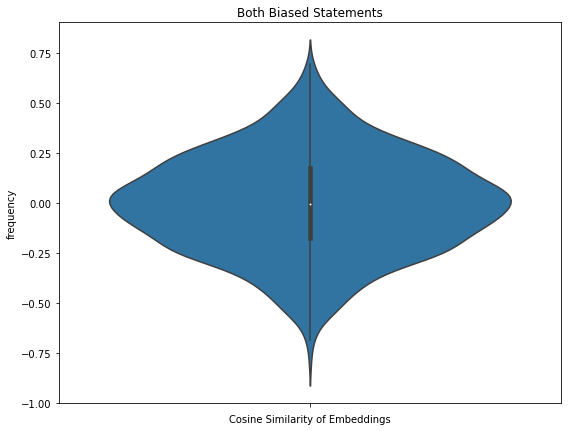

In [ ]:
import sklearn
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize =(9, 7))
sns.violinplot( ax = ax, y = cosine_similarity(df.loc[98].at['embedded'], df.loc[651].at['embedded']))
# plt.violinplot(cosine_similarity(df.loc[98].at['embedded'], df.loc[651].at['embedded']), 'black')
plt.xlabel('Cosine Similarity of Embeddings')
plt.ylabel('frequency')
plt.title('Both Biased Statements')
plt.savefig('use_biased',transparent=True)

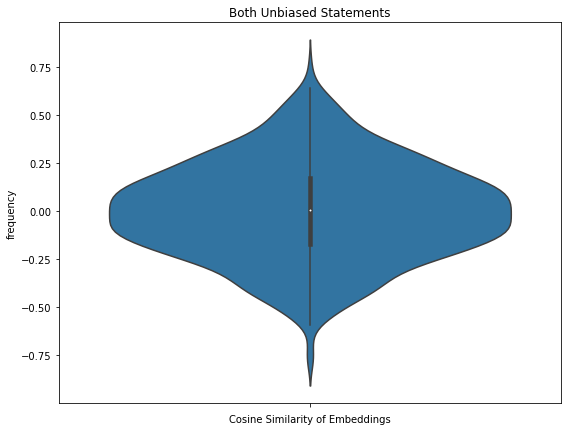

In [ ]:
import sklearn
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize =(9, 7))
sns.violinplot( ax = ax, y = cosine_similarity(df.loc[1073].at['embedded'], df.loc[1620].at['embedded']))
# plt.violinplot(cosine_similarity(df.loc[1073].at['embedded'], df.loc[1620].at['embedded']), )
plt.xlabel('Cosine Similarity of Embeddings')
plt.ylabel('frequency')
plt.title('Both Unbiased Statements')
plt.savefig('use_unbiased',transparent=True)

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

import tensorflow as tf
import tensorflow_hub as hub

base_document = "This is an example sentence for the document to be compared"
documents = ["This is the collection of documents to be compared against the base_document"]

def process_use_similarity():
	filename = "https://tfhub.dev/google/universal-sentence-encoder-large/2"

	model = hub.load(filename)

	base_embeddings = model([base_document])

	embeddings = model(documents)

	scores = cosine_similarity(base_embeddings, embeddings).flatten()

	highest_score = 0
	highest_score_index = 0
	for i, score in enumerate(scores):
		if highest_score < score:
			highest_score = score
			highest_score_index = i

	most_similar_document = documents[highest_score_index]
	print("Most similar document by USE with the score:", most_similar_document, highest_score)

process_use_similarity()

TypeError: ignored